In [254]:
import pandas as pd
import numpy as np
import os
import sys
import matplotlib.pyplot as plt
from matplotlib import cm
import ast
from collections import Counter
import itertools
import math

In [2]:
df = pd.read_csv('CLEAN_DATA.csv')
print(df.shape)
df.head()

(5964, 43)


,Unnamed: 0,file,county_x,labels,label_scores,colors,color_pixel_fraction,color_scores,chunk,chunk_index,...,AREALAND,INTPTLON,HU100,MTFCC,UR,COUNTY,CENT,INTPT,Census_Benchmark,Census_Vintage
0,0,/Volumes/Cooper_TB_Drive/research/readmissions...,Washtenaw,"['White', 'Black', 'Line']","[0.9736676812171936, 0.9484156370162964, 0.787...","[(255, 255, 255)]",[1.0],[1.0],1,0,...,87347883,-84.074559,1292,G5020,R,93,"(-84.0832181, 42.4668451)","(-84.0745589, 42.4721095)",Public_AR_Census2010,Census2000_Census2010
1,1,/Volumes/Cooper_TB_Drive/research/readmissions...,Washtenaw,"['White', 'Black', 'Line']","[0.9736676812171936, 0.9484156370162964, 0.787...","[(255, 255, 255)]",[1.0],[1.0],1,1,...,87347883,-84.074559,1292,G5020,R,93,"(-84.0832181, 42.4668451)","(-84.0745589, 42.4721095)",Public_AR_Census2010,Census2000_Census2010
2,2,/Volumes/Cooper_TB_Drive/research/readmissions...,Washtenaw,"['White', 'Black', 'Line']","[0.9736676812171936, 0.9484156370162964, 0.787...","[(255, 255, 255)]",[1.0],[1.0],1,10,...,87347883,-84.074559,1292,G5020,R,93,"(-84.0832181, 42.4668451)","(-84.0745589, 42.4721095)",Public_AR_Census2010,Census2000_Census2010
3,3,/Volumes/Cooper_TB_Drive/research/readmissions...,Washtenaw,"['White', 'Black', 'Line']","[0.9736676812171936, 0.9484156370162964, 0.787...","[(255, 255, 255)]",[1.0],[1.0],1,100,...,45286904,-83.980525,2290,G5020,M,93,"(-83.9657659, 42.4468299)","(-83.9805252, 42.4443108)",Public_AR_Census2010,Census2000_Census2010
4,4,/Volumes/Cooper_TB_Drive/research/readmissions...,Washtenaw,"['White', 'Black', 'Line']","[0.9736676812171936, 0.9484156370162964, 0.787...","[(255, 255, 255)]",[1.0],[1.0],1,101,...,45286904,-83.980525,2290,G5020,M,93,"(-83.9657659, 42.4468299)","(-83.9805252, 42.4443108)",Public_AR_Census2010,Census2000_Census2010


In [3]:
df.columns

Index(['Unnamed: 0', 'file', 'county_x', 'labels', 'label_scores', 'colors',
       'color_pixel_fraction', 'color_scores', 'chunk', 'chunk_index',
       'image_index', 'latitiude', 'longitude', 'projection', 'resolution',
       'metadata', 'county_y', 'window_size', 'chunk_file', 'POP100', 'GEOID',
       'CENTLAT', 'AREAWATER', 'STATE', 'BASENAME', 'OID', 'LSADC', 'FUNCSTAT',
       'INTPTLAT', 'NAME', 'OBJECTID', 'TRACT', 'CENTLON', 'AREALAND',
       'INTPTLON', 'HU100', 'MTFCC', 'UR', 'COUNTY', 'CENT', 'INTPT',
       'Census_Benchmark', 'Census_Vintage'],
      dtype='object')

In [100]:
def build_fig(size=(4, 4), dpi=200, axis_off=True):
    """A function to build a matplotlib figure. Primary
    goal is to sandardize the easy stuff.
    Args:
        - title (str): the title of the plot
        - axis_off (bool): should the axis be printed?
        - size (tuple): how big should the plot be?
        - y_lab (str): y axis label
        - x_lab (str): x axis label
    Returns:
        fig (plt.figure)
    """
    fig = plt.figure(figsize=size, 
                    facecolor='w',
                    dpi=dpi)

    if axis_off:
        plt.axis('off')
    return fig

(42.425, -83.858)
['Brown', 'Wall', 'Soil', 'Beige', 'Line', 'Floor', 'Pattern', 'Flooring', 'Metal']


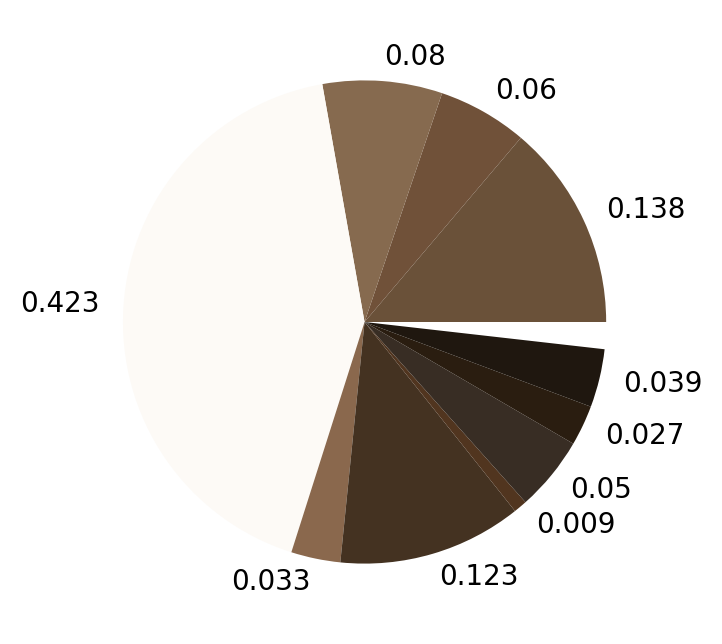

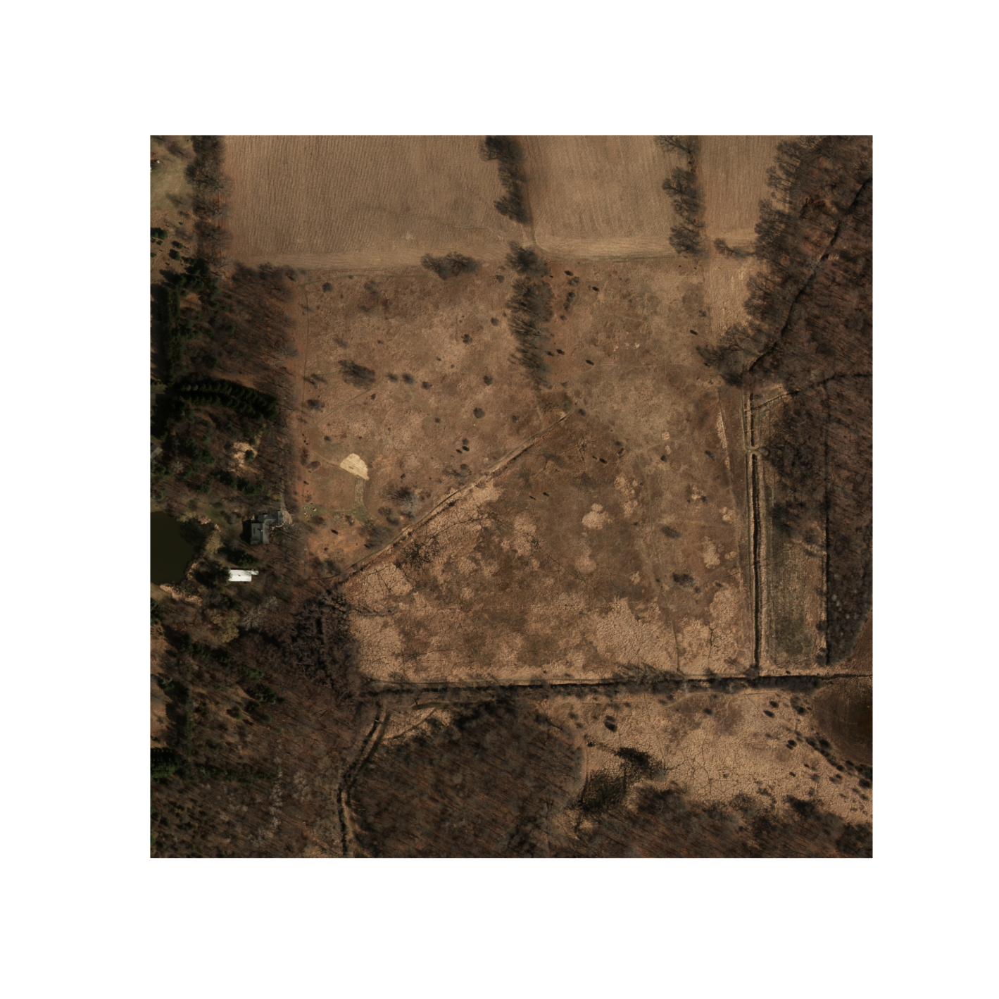

In [72]:
"""
A few sanity checks
"""

test = df.sample(1)
lat = test['latitiude'].values[0]
lon = test['longitude'].values[0]
f_path = test['file'].values[0]

labels = ast.literal_eval(test['labels'].values[0])
fracs = ast.literal_eval(test['color_pixel_fraction'].values[0])
fracs = [np.round(i, 3) for i in fracs]

colors = ast.literal_eval(test['colors'].values[0])

normed_cols = []
for idx, tup in enumerate(colors):
    new_tup = np.array(tup).astype(float) / 255.0
    normed_cols.append(tuple(new_tup))

print(f"({lat:.3f}, {lon:.3f})")
print(labels)
fig, ax = plt.subplots(figsize=(4, 4), dpi=200)
pie = ax.pie(fracs, colors=normed_cols, labels=fracs)

fig = build_fig(size=(6, 6), dpi=300)
plt.imshow(plt.imread(f_path))

In [73]:
ast.literal_eval(test['label_scores'].values[0])


[0.8910658955574036,
 0.832007110118866,
 0.7800834774971008,
 0.7591366767883301,
 0.7295002341270447,
 0.6561227440834045,
 0.5630630254745483,
 0.539529025554657,
 0.5114516019821167]

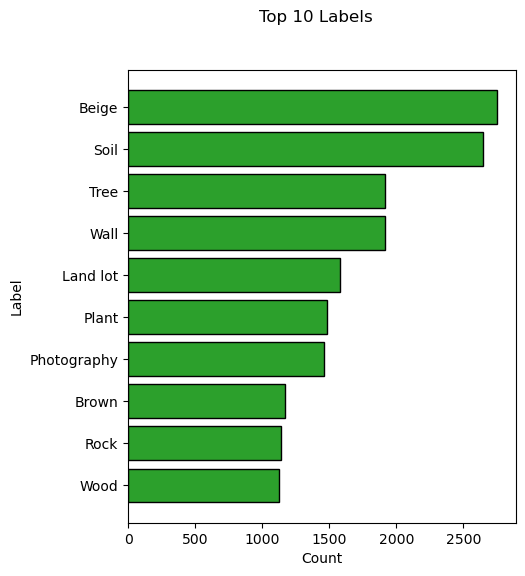

In [114]:
N_MOST_COMMON = 10
labels = df['labels'].apply(ast.literal_eval).to_list()
labels = list(itertools.chain.from_iterable(labels))
c = Counter(labels)
tmp = pd.DataFrame(c.most_common(N_MOST_COMMON))
tmp.columns = ['Label','Count']

fig = build_fig(size=(5, 6), dpi=100, axis_off=False)
plt.barh(y=tmp['Label'], width=tmp['Count'], color='C12', edgecolor='black')
plt.suptitle(f"Top {N_MOST_COMMON} Labels")
plt.xlabel('Count')
plt.ylabel('Label')
plt.gca().invert_yaxis()

11.180339887498949

num images for Census Tract 7439 == 5
num images for Census Tract 7438 == 30
num images for Census Tract 4480 == 238
num images for Census Tract 4026 == 7
num images for Census Tract 4145 == 6
num images for Census Tract 4160 == 11
num images for Census Tract 4143 == 6
num images for Census Tract 68.02 == 66
num images for Census Tract 7449 == 24
num images for Census Tract 4158 == 15
num images for Census Tract 4440 == 232
num images for Census Tract 4004 == 2
num images for Census Tract 4236 == 7
num images for Census Tract 4003 == 4
num images for Census Tract 5881 == 24
num images for Census Tract 4032 == 9
num images for Census Tract 1374 == 4
num images for Census Tract 4056 == 5
num images for Census Tract 4560 == 43
num images for Census Tract 4102 == 5
num images for Census Tract 5645 == 24
num images for Census Tract 7446 == 11
num images for Census Tract 1381 == 28
num images for Census Tract 4152 == 3
num images for Census Tract 601 == 90
num images for Census Tract 4127 ==

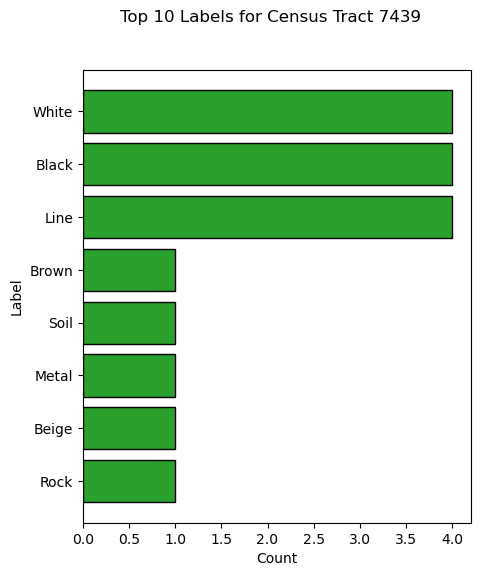

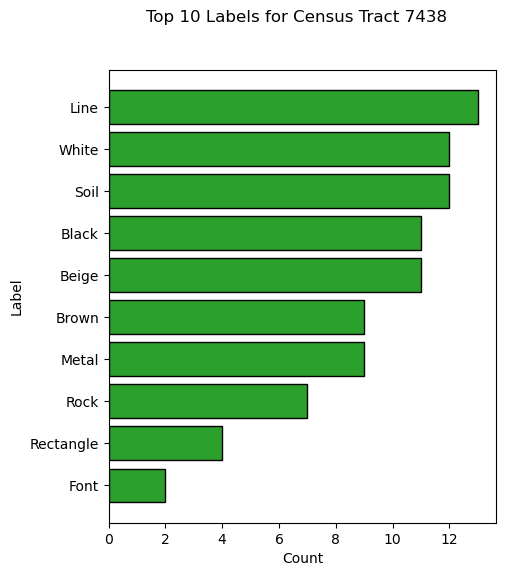

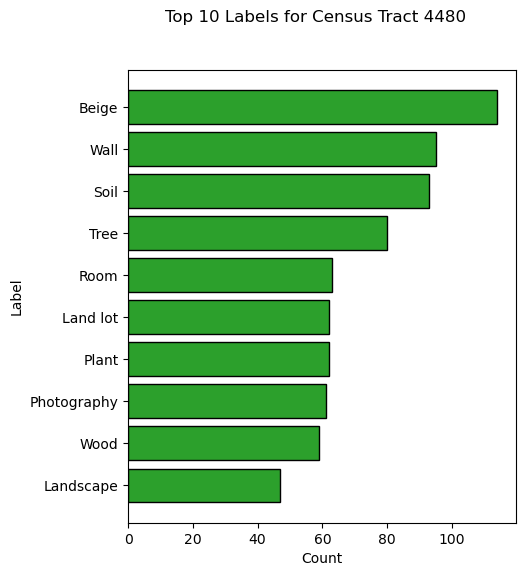

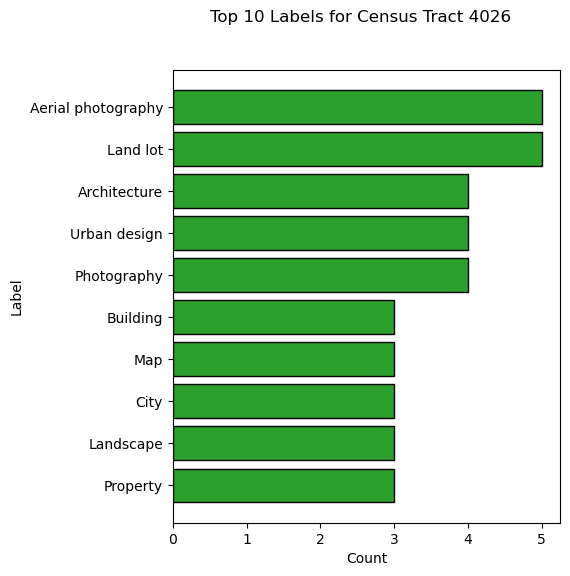

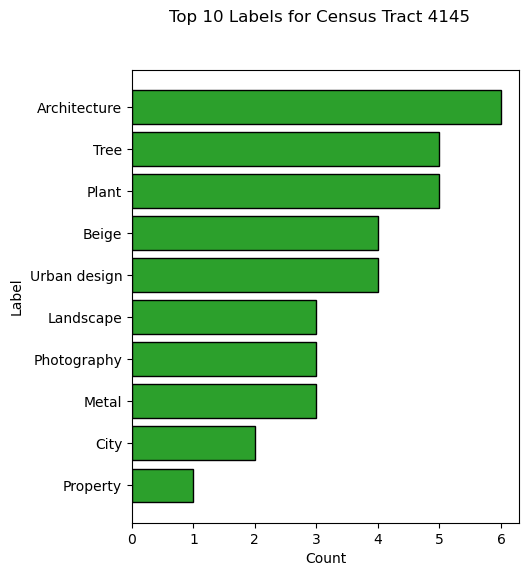

...

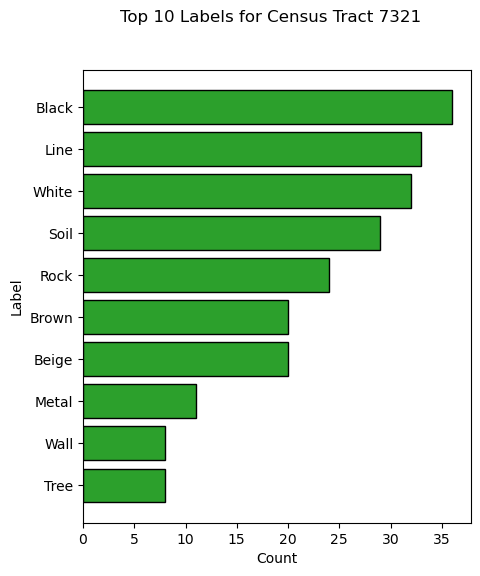

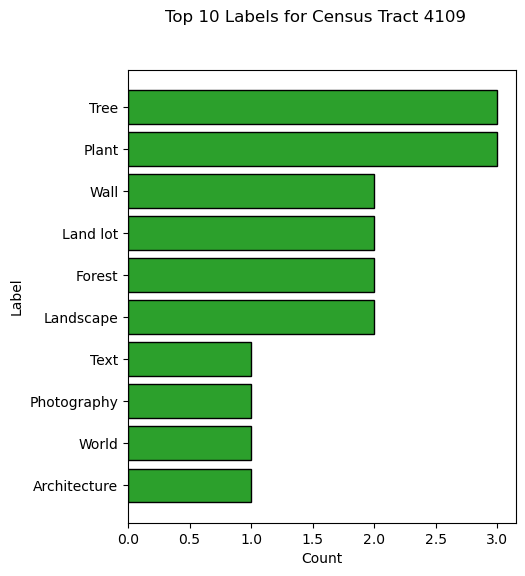

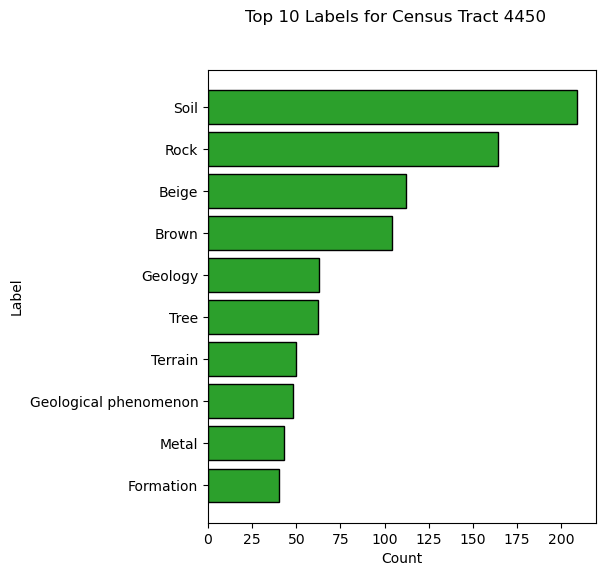

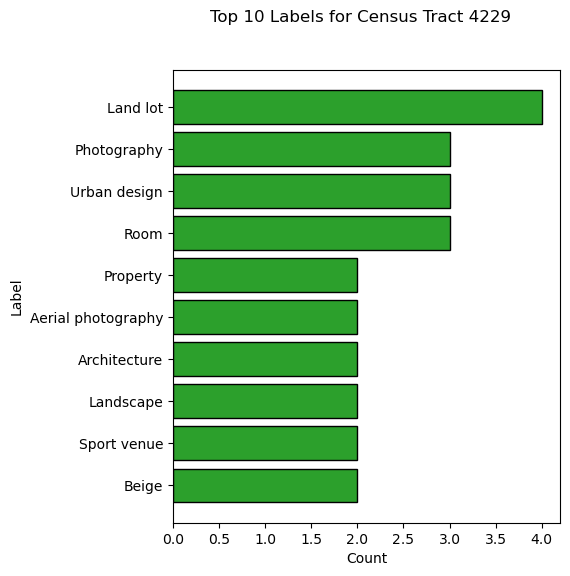

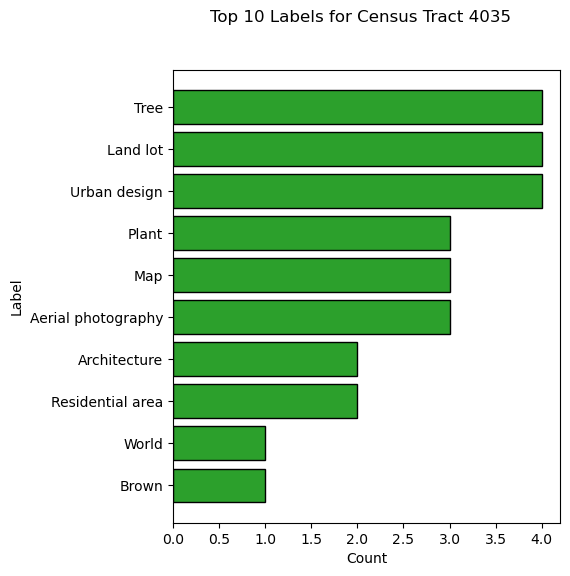

In [118]:
for tract in set(df['NAME']):
    subset = df[df['NAME'] == tract]

    N_MOST_COMMON = 10
    labels = subset['labels'].apply(ast.literal_eval).to_list()
    labels = list(itertools.chain.from_iterable(labels))
    c = Counter(labels)
    tmp = pd.DataFrame(c.most_common(N_MOST_COMMON))
    tmp.columns = ['Label','Count']

    fig = build_fig(size=(5, 6), dpi=100, axis_off=False)
    plt.barh(y=tmp['Label'], width=tmp['Count'], color='C12', edgecolor='black')
    plt.suptitle(f"Top {N_MOST_COMMON} Labels for {tract} ({len(subset)} images)")
    plt.xlabel('Count')
    plt.ylabel('Label')
    plt.gca().invert_yaxis()


CPU times: user 2.12 s, sys: 23.3 ms, total: 2.14 s
Wall time: 2.16 s


Text(0, 0.5, 'Longitude')

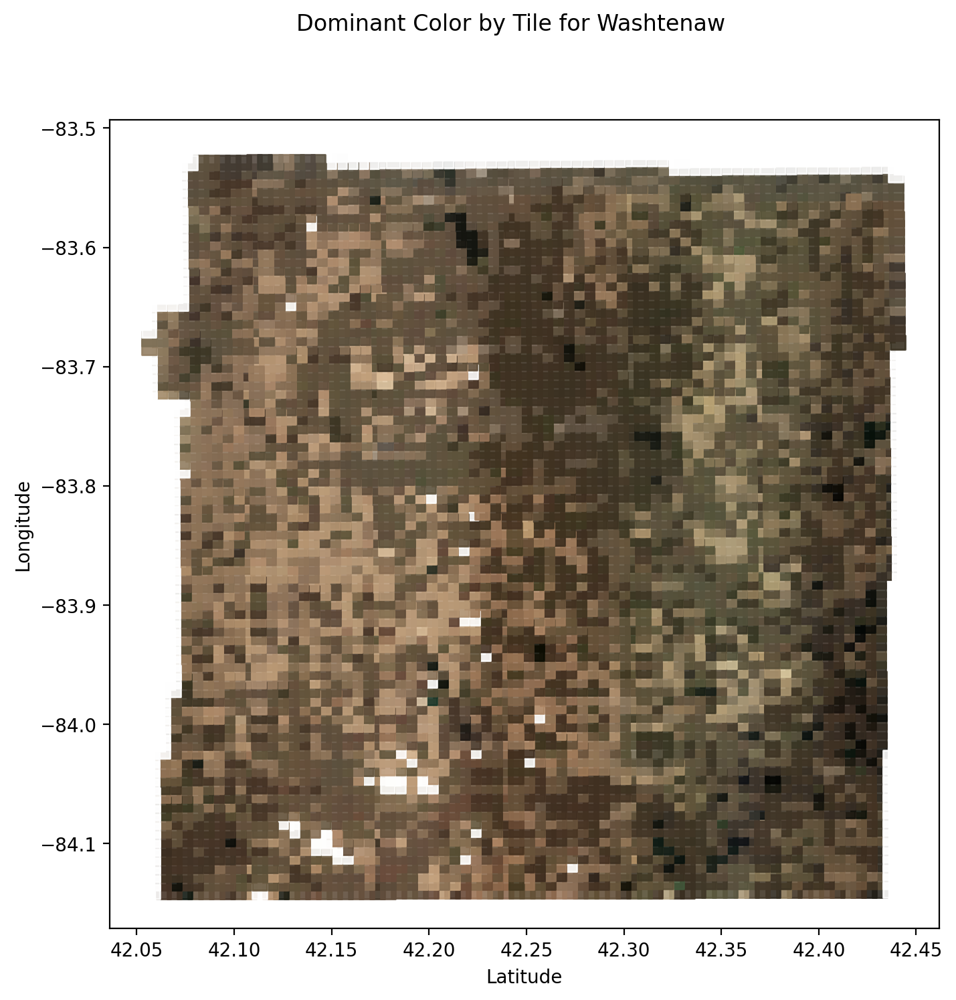

In [205]:
%%time

N_DOMINANT_COL = 0

dominant_colors = []

for idx, row in df.iterrows():
    colors = ast.literal_eval(row['colors'])

    if len(colors) > N_DOMINANT_COL:
        normed_dcolor = np.array(colors[N_DOMINANT_COL]).astype(float) / 255.0
    else:
        normed_dcolor = np.array([1.0, 1.0, 1.0])

    dominant_colors.append(normed_dcolor)


x = df['latitiude'].to_numpy()
y = df['longitude'].to_numpy()

fig = build_fig(size=(8, 8), dpi=200, axis_off=False)
plt.scatter(x, y, color=dominant_colors, s=60, marker="s", alpha=0.9)
plt.suptitle(f"Dominant Color by Tile for Washtenaw")
plt.xlabel('Latitude')
plt.ylabel('Longitude')



In [185]:
df.columns

Index(['Unnamed: 0', 'file', 'county_x', 'labels', 'label_scores', 'colors',
       'color_pixel_fraction', 'color_scores', 'chunk', 'chunk_index',
       'image_index', 'latitiude', 'longitude', 'projection', 'resolution',
       'metadata', 'county_y', 'window_size', 'chunk_file', 'POP100', 'GEOID',
       'CENTLAT', 'AREAWATER', 'STATE', 'BASENAME', 'OID', 'LSADC', 'FUNCSTAT',
       'INTPTLAT', 'NAME', 'OBJECTID', 'TRACT', 'CENTLON', 'AREALAND',
       'INTPTLON', 'HU100', 'MTFCC', 'UR', 'COUNTY', 'CENT', 'INTPT',
       'Census_Benchmark', 'Census_Vintage'],
      dtype='object')

CPU times: user 502 ms, sys: 13.9 ms, total: 516 ms
Wall time: 572 ms


Text(0.5, 0, 'Longitude')

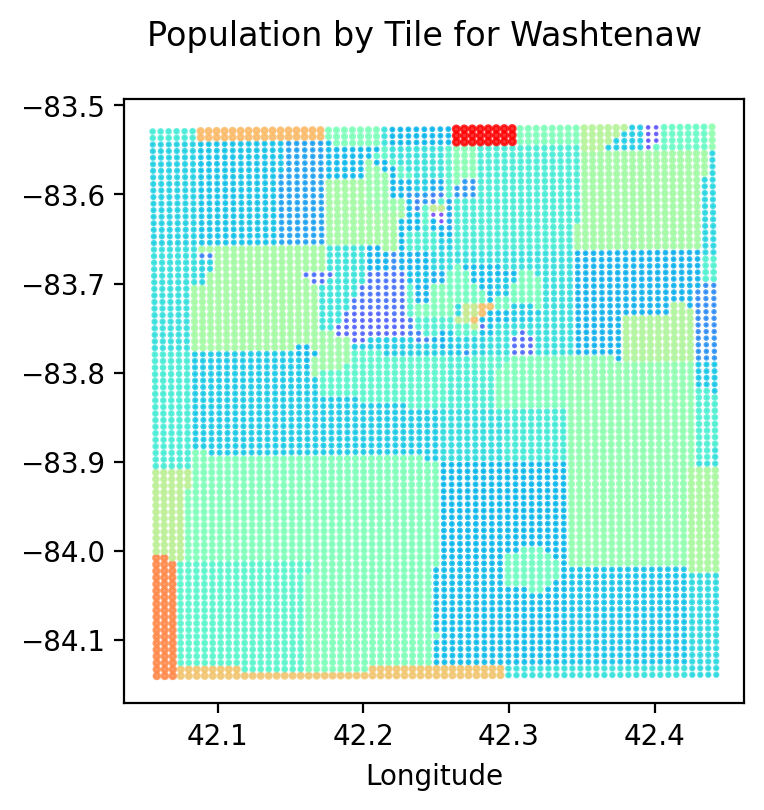

In [227]:
%%time
    
cmap = cm.get_cmap('rainbow')

pop_arr = df['POP100'].to_numpy().astype(float)
pop = (pop_arr / pop_arr.max())
colors = [cmap(i) for i in pop]
x = df['latitiude'].to_numpy()
y = df['longitude'].to_numpy()


fig = build_fig(size=(4, 4), dpi=200, axis_off=False)
plt.scatter(x, y, color=colors, s=pop * 5, marker="o", alpha=0.8)
plt.suptitle(f"Population by Tile for Washtenaw")
plt.xlabel('Latitude')
plt.xlabel('Longitude')

CPU times: user 465 ms, sys: 14.6 ms, total: 479 ms
Wall time: 500 ms


Text(0.5, 0, 'Longitude')

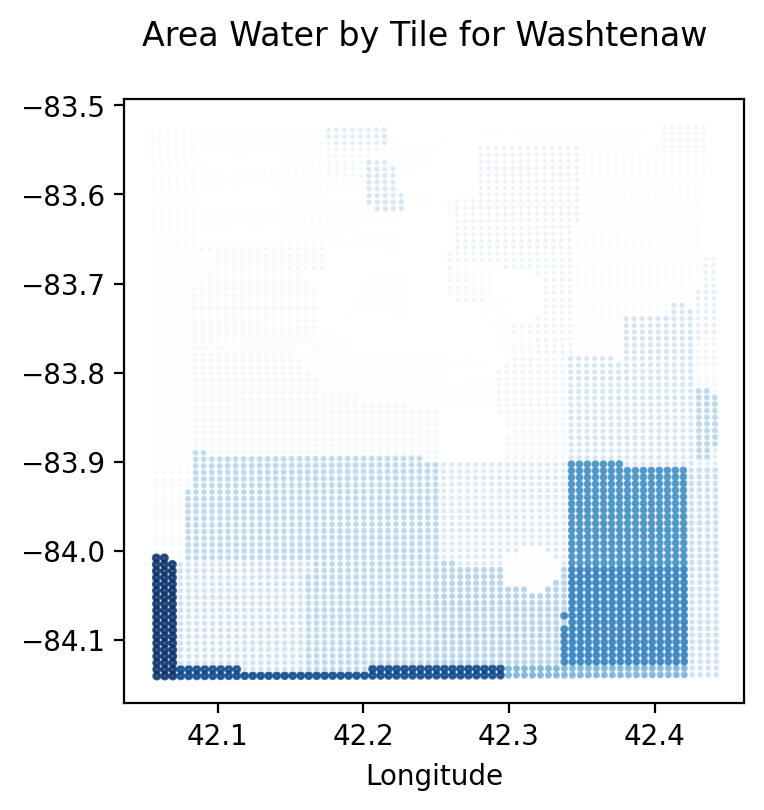

In [223]:
%%time
    
cmap = cm.get_cmap('Blues')

pop_arr = df['AREAWATER'].to_numpy().astype(float)
pop = (pop_arr / pop_arr.max())
colors = [cmap(i) for i in pop]
x = df['latitiude'].to_numpy()
y = df['longitude'].to_numpy()


fig = build_fig(size=(4, 4), dpi=200, axis_off=False)
plt.scatter(x, y, color=colors, s=pop * 5, marker="o", alpha=0.8)
plt.suptitle(f"Area Water by Tile for Washtenaw")
plt.xlabel('Latitude')
plt.xlabel('Longitude')

CPU times: user 477 ms, sys: 10.8 ms, total: 488 ms
Wall time: 520 ms


Text(0.5, 0, 'Latitude')

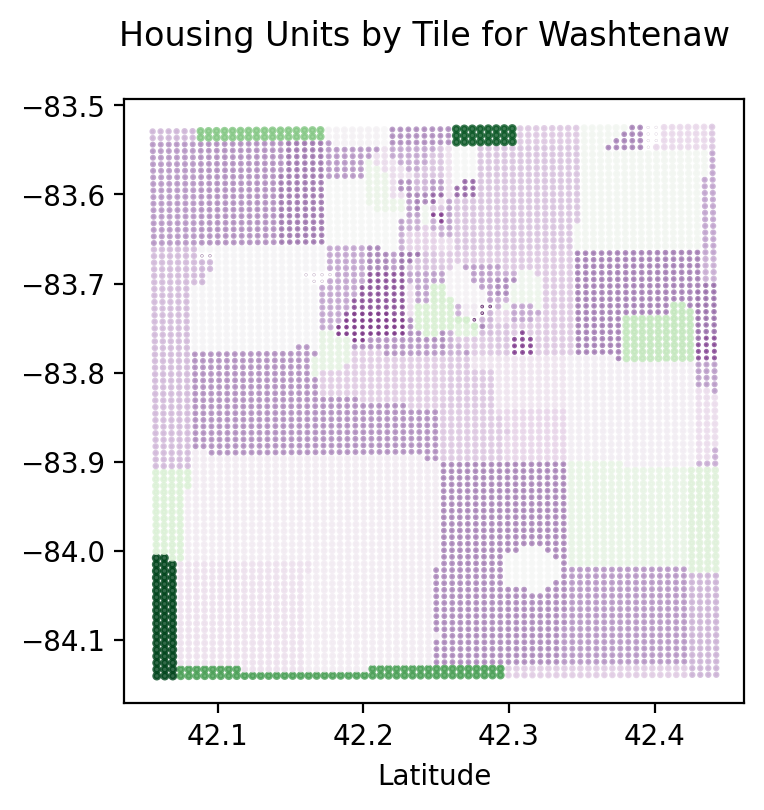

In [220]:
%%time
    
cmap = cm.get_cmap('PRGn')

pop_arr = df['HU100'].to_numpy().astype(float)
pop = (pop_arr / pop_arr.max())
colors = [cmap(i) for i in pop]
x = df['latitiude'].to_numpy()
y = df['longitude'].to_numpy()


fig = build_fig(size=(4, 4), dpi=200, axis_off=False)
plt.scatter(x, y, color=colors, s=pop * 5, marker="o", alpha=0.8)
plt.suptitle(f"Housing Units by Tile for Washtenaw")
plt.xlabel('Latitude')
plt.xlabel('Longitude')

In [246]:
tmp = pd.DataFrame(df['NAME'].value_counts())
tmp

,NAME
Census Tract 4320,771
Census Tract 4260,369
Census Tract 4310,266
Census Tract 4610,255
Census Tract 4222,241
...,...
Census Tract 4219,2
Census Tract 4110,2
Census Tract 4107,2
Census Tract 4042,1


CPU times: user 217 ms, sys: 4.88 ms, total: 222 ms
Wall time: 247 ms


Text(0.5, 0, 'Longitude')

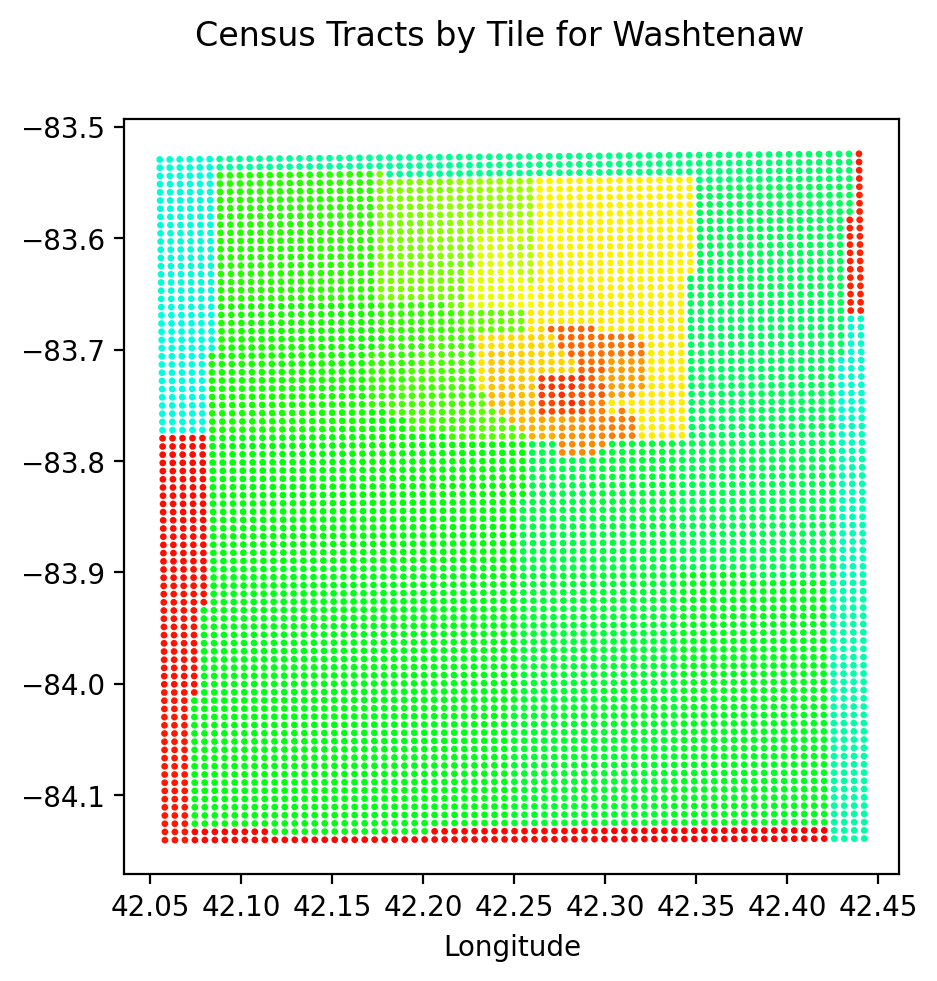

In [253]:

%%time
    
cmap = cm.get_cmap('hsv')
pop = df['TRACT'].astype('category').cat.codes.to_numpy().astype(int)

colors = [cmap(i) for i in pop]
x = df['latitiude'].to_numpy()
y = df['longitude'].to_numpy()


fig = build_fig(size=(5, 5), dpi=200, axis_off=False)
plt.scatter(x, y, color=colors, s=2, marker="o")
plt.suptitle(f"Census Tracts by Tile for Washtenaw")
plt.xlabel('Latitude')
plt.xlabel('Longitude')